# Visualización de objetos de estudio

In [2]:
import pandas as pd
import numpy as np
import geopandas as gpd
import shapely
from shapely.geometry import *
import matplotlib.pyplot as plt
import pyrosm
from pyrosm.data import sources
from shapely import wkt
import seaborn as sns

sns.set(palette='viridis', context='notebook', font_scale=1.0, font='DejaVu Sans')
%config InlineBackend.figure_format = 'retina'
%matplotlib inline

/home/jsepulveda/miniconda3/envs/myenv/lib/python3.9/site-packages/geopandas/_compat.py:106: UserWarning: The Shapely GEOS version (3.8.0-CAPI-1.13.1 ) is incompatible with the GEOS version PyGEOS was compiled with (3.9.0-CAPI-1.16.2). Conversions between both will be slow.
  warnings.warn(


### Se lee el archivo csv generado con los pois a estudiar

In [3]:
amenity_pois = pd.read_csv('/home/jsepulveda/files/amenity_points.csv')
amenity_pois['geometry'] = amenity_pois['geometry'].apply(wkt.loads)
amenity_gdf = gpd.GeoDataFrame(amenity_pois, crs='epsg:4326')

### Se lee el archivo con los shapes de distritos urbanos y comunas urbanas

In [4]:
urban_distritos = gpd.read_file('/home/jsepulveda/urban_distritos.shp')
urban_comunas = gpd.read_file('/home/jsepulveda/urban_comunas.shp')
urban_comunas.head()

,REGION,NOM_REGION,PROVINCIA,NOM_PROVIN,COMUNA,NOM_COMUNA,SHAPE_Leng,SHAPE_Area,geometry
0,13,REGIÓN METROPOLITANA DE SANTIAGO,131,SANTIAGO,13124,PUDAHUEL,0.720176,0.019124,"POLYGON ((-70.78216 -33.41714, -70.78216 -33.4..."
1,13,REGIÓN METROPOLITANA DE SANTIAGO,131,SANTIAGO,13103,CERRO NAVIA,0.170180,0.001076,"POLYGON ((-70.71927 -33.41334, -70.71888 -33.4..."
2,13,REGIÓN METROPOLITANA DE SANTIAGO,133,CHACABUCO,13302,LAMPA,1.046716,0.043569,"POLYGON ((-70.71901 -33.32442, -70.71902 -33.3..."
3,13,REGIÓN METROPOLITANA DE SANTIAGO,131,SANTIAGO,13107,HUECHURABA,0.326251,0.004350,"POLYGON ((-70.60223 -33.38550, -70.60222 -33.3..."
4,13,REGIÓN METROPOLITANA DE SANTIAGO,131,SANTIAGO,13104,CONCHALÍ,0.138248,0.001077,"POLYGON ((-70.69041 -33.36579, -70.69028 -33.3..."


### Se lee el archivo con las torres y sus ubicaciones


In [5]:
torres = pd.read_csv('/home/jsepulveda/torres_clean.csv')
torres['geometry'] = torres['geometry'].apply(wkt.loads)
torres_gdf = gpd.GeoDataFrame(torres, crs='epsg:4326')
torres_gdf.head()

,rinhead,geometry,NOM_COMUNA
0,11SEP,POINT (-70.61111 -33.42227),PROVIDENCIA
1,ALBER,POINT (-70.63374 -33.43539),PROVIDENCIA
2,ATICF,POINT (-70.60563 -33.42468),PROVIDENCIA
3,AVIUM,POINT (-70.62628 -33.44031),PROVIDENCIA
4,BARRO,POINT (-70.61785 -33.43059),PROVIDENCIA


### Se lee el archivo con la ruta de la L6 del Metro de Santiago

In [6]:
ruta = pd.read_csv('/home/jsepulveda/files/l6_route.csv')
ruta['geometry'] = ruta['geometry'].apply(wkt.loads)
ruta_gdf = gpd.GeoDataFrame(ruta, crs='epsg:4326')

### Se visualiza toda la información recopilada, el mapa de la RM dividido por comunas y distritos con los pois de recreación y eduación, las torres, y finalmente la Línea 6 del Metro de Santiago

In [7]:
import matplotlib.patheffects as path_effects

try:
    from adjustText import adjust_text
except:
    adjust_text = lambda *x,**y: x
    

text_style = dict(horizontalalignment='center', fontsize=13, fontweight='bold'
                 ,color='white', fontstretch='condensed')
text_effects = [path_effects.Stroke(linewidth=2, foreground='black'), path_effects.Normal()]   

/home/jsepulveda/miniconda3/envs/myenv/lib/python3.9/site-packages/geopandas/plotting.py:641: UserWarning: Only specify one of 'column' or 'color'. Using 'color'.
  warnings.warn(


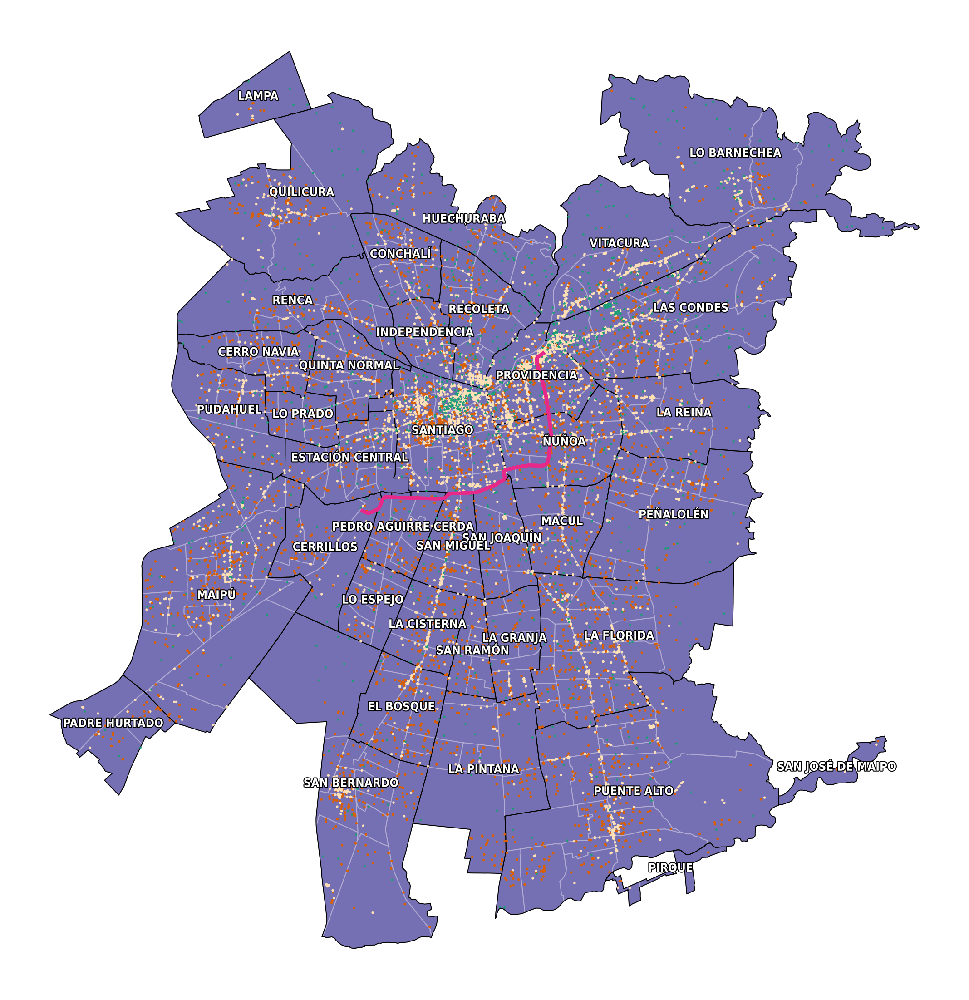

In [8]:
colors=['#d95f02' if amenity == 'Educacion' else '#fee0b6' for amenity in amenity_gdf.amenity] #naranjo educacion
ax = urban_distritos.plot(figsize=(20,20),linewidth=1, edgecolor='#b2abd2', facecolor='#7570b3')
ax = urban_comunas.plot(linewidth=1, edgecolor='black', facecolor="none", ax=ax)
ax = amenity_gdf.plot(column='amenity', figsize=(20,20),markersize=3,legend=True,ax=ax, color = colors)
ax = torres_gdf.plot(marker='*', color='#1b9e77',markersize=3,ax=ax)
ax = ruta_gdf.plot(color='#e7298a',linewidth=4,ax=ax)


texts = []
for comuna, centroid in zip(urban_comunas['NOM_COMUNA'], urban_comunas.centroid):
    t = ax.text(centroid.x, centroid.y, comuna, **text_style)
    t.set_path_effects(text_effects)
    texts.append(t)
adjust_text(texts, autoalign='y', lim=1)
    
ax.axis('off');

/home/jsepulveda/miniconda3/envs/myenv/lib/python3.9/site-packages/geopandas/plotting.py:641: UserWarning: Only specify one of 'column' or 'color'. Using 'color'.
  warnings.warn(


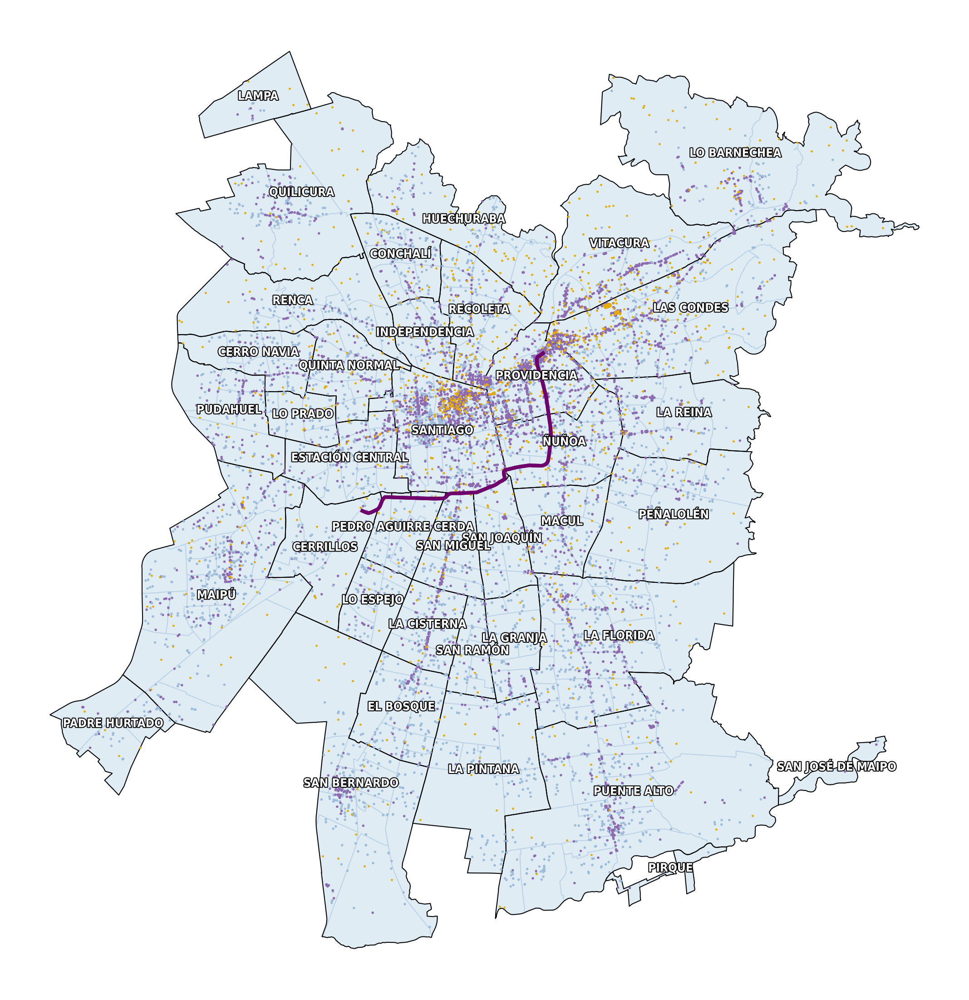

In [9]:
colors=['#9ebcda' if amenity == 'Educacion' else '#8c6bb1' for amenity in amenity_gdf.amenity]
ax = urban_distritos.plot(figsize=(20,20),linewidth=1, edgecolor='#bfd3e6', facecolor='#e0ecf4')
ax = urban_comunas.plot(linewidth=1, edgecolor='black', facecolor="none", ax=ax)
ax = amenity_gdf.plot(column='amenity', figsize=(20,20),markersize=3,legend=True,ax=ax, color = colors)
ax = torres_gdf.plot(marker='*', color='#e6ab02',markersize=3,ax=ax)
ax = ruta_gdf.plot(color='#6e016b',linewidth=4,ax=ax)


texts = []
for comuna, centroid in zip(urban_comunas['NOM_COMUNA'], urban_comunas.centroid):
    t = ax.text(centroid.x, centroid.y, comuna, **text_style)
    t.set_path_effects(text_effects)
    texts.append(t)
adjust_text(texts, autoalign='y', lim=1)
    
ax.axis('off');

/home/jsepulveda/miniconda3/envs/myenv/lib/python3.9/site-packages/geopandas/plotting.py:641: UserWarning: Only specify one of 'column' or 'color'. Using 'color'.
  warnings.warn(


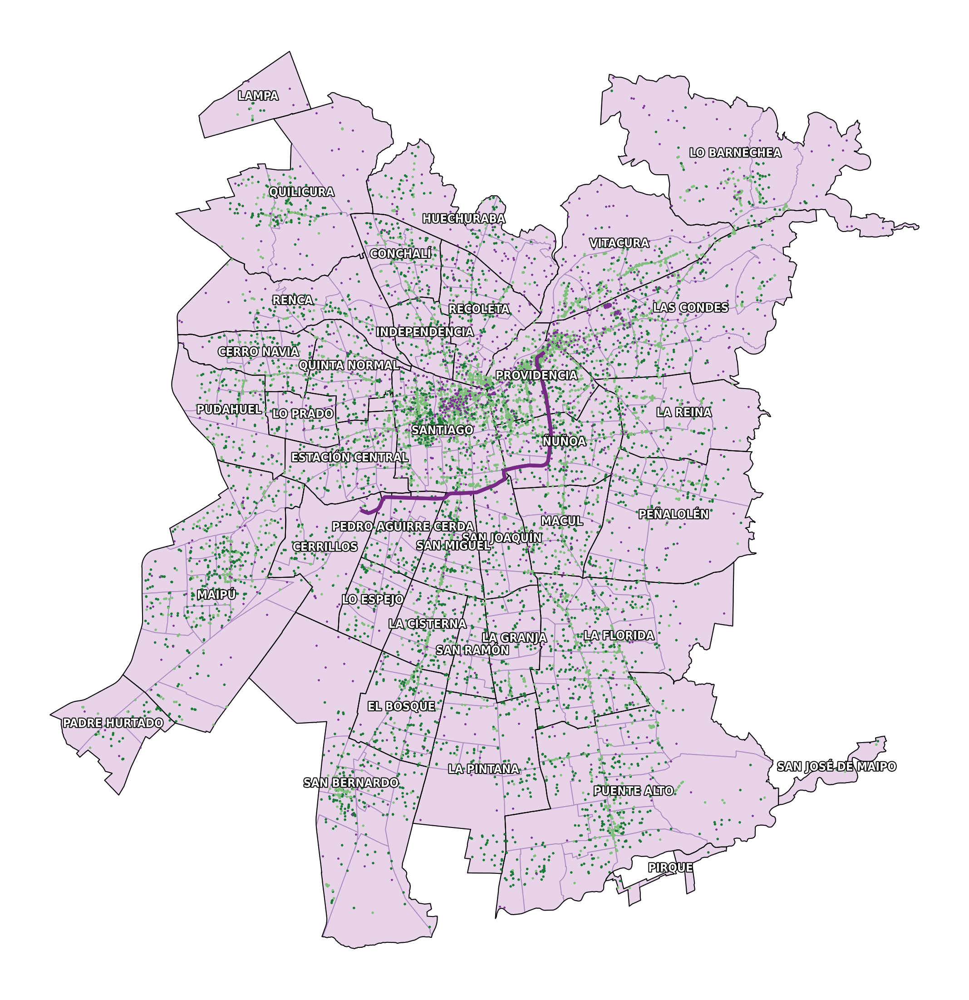

In [10]:
colors=['#1b7837' if amenity == 'Educacion' else '#7fbf7b' for amenity in amenity_gdf.amenity]
ax = urban_distritos.plot(figsize=(20,20),linewidth=1, edgecolor='#af8dc3', facecolor='#e7d4e8')
ax = urban_comunas.plot(linewidth=1, edgecolor='black', facecolor="none", ax=ax)
ax = amenity_gdf.plot(column='amenity', figsize=(20,20),markersize=3,legend=True,ax=ax, color = colors)
ax = torres_gdf.plot(marker='*', color='#7b3294',markersize=3,ax=ax)
ax = ruta_gdf.plot(color='#762a83',linewidth=4,ax=ax)


texts = []
for comuna, centroid in zip(urban_comunas['NOM_COMUNA'], urban_comunas.centroid):
    t = ax.text(centroid.x, centroid.y, comuna, **text_style)
    t.set_path_effects(text_effects)
    texts.append(t)
adjust_text(texts, autoalign='y', lim=1)
    
ax.axis('off');

### Se analiza por cada elemento del mapa, POIs de Educación, Recreación y Torres

In [12]:
urban_distritos = urban_distritos.set_crs("EPSG:4326")
urban_distritos_educacion = gpd.sjoin(amenity_gdf,urban_distritos, how='inner', op = 'intersects').reset_index().drop(['index_right','index'], axis = 1)

indexNames = urban_distritos_educacion[(urban_distritos_educacion['amenity'] != 'Educacion')].index
urban_distritos_educacion.drop(indexNames, inplace=True)
columnas_delete_e = ['Unnamed: 0', 'id', 'changeset', 'lat', 'timestamp', 'tags', 'version',
       'lon', 'addr:city', 'addr:country', 'addr:full', 'addr:housenumber',
       'addr:housename', 'addr:postcode', 'addr:street', 'email', 'name',
       'opening_hours', 'operator', 'phone', 'ref', 'website',
       'atm', 'bicycle_parking', 'bar', 'building', 'building:levels',
       'drinking_water', 'internet_access', 'landuse', 'office', 'parking',
       'social_facility', 'source', 'start_date', 'wikipedia', 'car',
       'clothes', 'craft', 'organic', 'religion', 'second_hand', 'shoes',
       'shop', 'trade', 'attraction', 'guest_house', 'information', 'museum',
       'tourism', 'zoo', 'geometry', 'osm_type', 'cafe', 'school', 'water',
       'wholesale', 'REGION', 'NOM_REGION', 'PROVINCIA', 'NOM_PROVIN',
       'NOM_COMUNA', 'TIPO_DISTR', 'SHAPE_Leng',
       'SHAPE_Area']

urban_distritos_e = urban_distritos_educacion.drop(columnas_delete_e, axis = 1)
pois_e_distritos = urban_distritos_e.groupby(['COMUNA','COD_DISTRI']).count().unstack(fill_value=0).stack()
pois_e_distritos.rename(columns={'amenity':'Educacion'}, inplace = True)
pois_e_distritos.head()

Educacion
COMUNA COD_DISTRI           
13101  1                   3
       2                   6
       3                   6
       4                  25
       5                  18

In [15]:
urban_distritos = urban_distritos.set_crs("EPSG:4326")
urban_distritos_recreacion = gpd.sjoin(amenity_gdf,urban_distritos, how='inner', op = 'intersects').reset_index().drop(['index_right','index'], axis = 1)
indexNames = urban_distritos_recreacion[(urban_distritos_recreacion['amenity'] != 'Recreacion')].index
urban_distritos_recreacion.drop(indexNames, inplace=True)
columnas_delete_r = ['Unnamed: 0', 'id', 'changeset', 'lat', 'timestamp', 'tags', 'version',
       'lon', 'addr:city', 'addr:country', 'addr:full', 'addr:housenumber',
       'addr:housename', 'addr:postcode', 'addr:street', 'email', 'name',
       'opening_hours', 'operator', 'phone', 'ref', 'website',
       'atm', 'bicycle_parking', 'bar', 'building', 'building:levels',
       'drinking_water', 'internet_access', 'landuse', 'office', 'parking',
       'social_facility', 'source', 'start_date', 'wikipedia', 'car',
       'clothes', 'craft', 'organic', 'religion', 'second_hand', 'shoes',
       'shop', 'trade', 'attraction', 'guest_house', 'information', 'museum',
       'tourism', 'zoo', 'geometry', 'osm_type', 'cafe', 'school', 'water',
       'wholesale', 'REGION', 'NOM_REGION', 'PROVINCIA', 'NOM_PROVIN',
       'NOM_COMUNA', 'TIPO_DISTR', 'SHAPE_Leng',
       'SHAPE_Area']

urban_distritos_r = urban_distritos_recreacion.drop(columnas_delete_r, axis = 1)
pois_r_distritos = urban_distritos_r.groupby(['COMUNA','COD_DISTRI']).count().unstack(fill_value=0).stack()
pois_r_distritos.rename(columns={'amenity':'Recreacion'}, inplace = True)
pois_r_distritos.head()

Recreacion
COMUNA COD_DISTRI            
13101  1                  142
       2                  169
       3                   21
       4                   63
       5                   34

In [16]:
urban_distritos = urban_distritos.set_crs("EPSG:4326")
urban_distritos_torres = gpd.sjoin(torres_gdf,urban_distritos, how='inner', op = 'intersects').reset_index().drop(['index_right','index'], axis = 1)
columnas_delete = ['geometry', 'NOM_COMUNA_left', 'REGION', 'NOM_REGION',
       'PROVINCIA', 'NOM_PROVIN', 'NOM_COMUNA_right',
       'TIPO_DISTR', 'SHAPE_Leng', 'SHAPE_Area']
urban_distritos_t = urban_distritos_torres.drop(columnas_delete, axis = 1)
torres_distritos = urban_distritos_t.groupby(['COMUNA','COD_DISTRI']).count().unstack(fill_value=0).stack()
torres_distritos.rename(columns={'rinhead':'Torres'}, inplace = True)
torres_distritos.head()

Torres
COMUNA COD_DISTRI        
13101  1               16
       2               70
       3               14
       4                3
       5                1

### Juntamos los 3 Dataframes creados

In [17]:
data = pd.concat([pois_e_distritos,pois_r_distritos, torres_distritos], axis=1).fillna(0).astype(np.int)
data.to_csv('/home/jsepulveda/files/data_count.csv')
data.head()

Educacion  Recreacion  Torres
COMUNA COD_DISTRI                               
13101  1                   3         142      16
       2                   6         169      70
       3                   6          21      14
       4                  25          63       3
       5                  18          34       1

In [18]:
urban_distritos = gpd.read_file('/home/jsepulveda/urban_distritos.shp').set_index(['COMUNA','COD_DISTRI'])


In [19]:
def plot_distritos(df, column=None, title=None, legend=True, cmap='BuPu', scheme='quantiles'):
    ax = urban_distritos.join(df).plot(figsize=(20,20), linewidth=1, edgecolor='white', column=column, legend=legend, scheme=scheme, cmap=cmap)
    ax = urban_comunas.plot(linewidth=2, edgecolor='black', facecolor="none", ax=ax)

    texts = []
    for comuna, centroid in zip(urban_comunas['NOM_COMUNA'], urban_comunas.centroid):
        t = ax.text(centroid.x, centroid.y, comuna, **text_style)
        t.set_path_effects(text_effects)
        texts.append(t)
    adjust_text(texts, autoalign='y', lim=1)
    ax.set_title(title,fontsize=20)
    ax.axis('off')

### Visualizamos las cloropletas por cada elemento estudiado

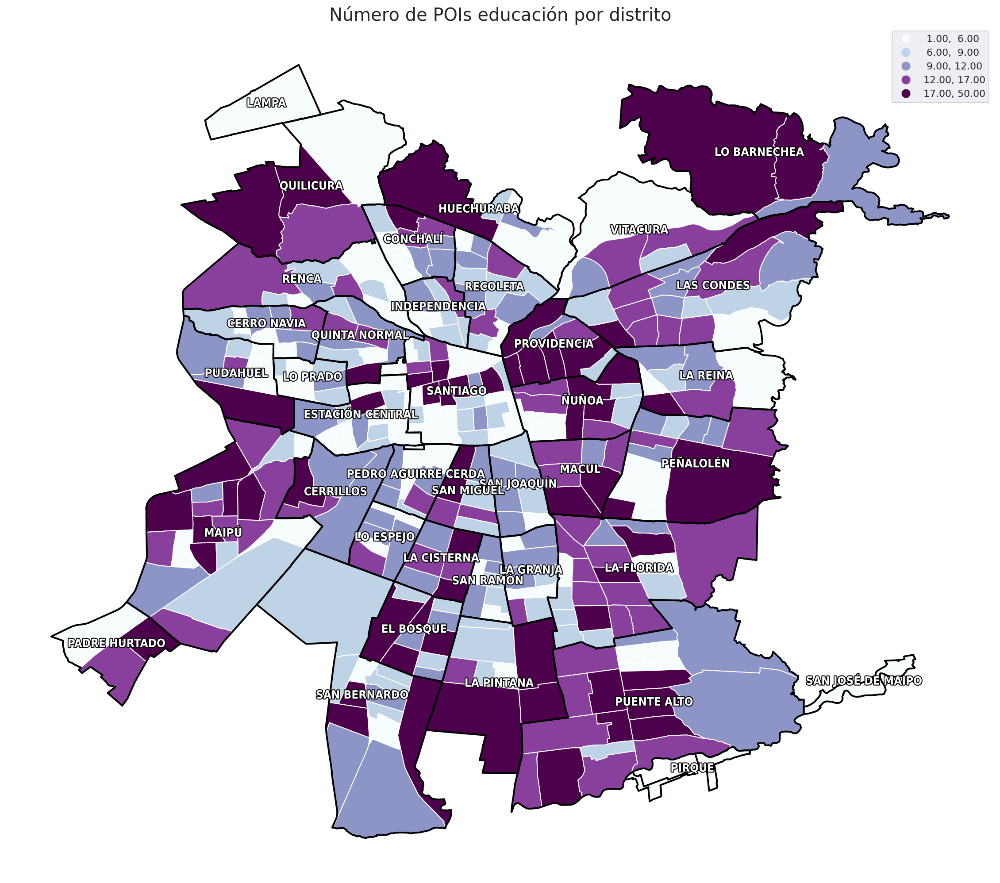

In [20]:
plot_distritos(data, column='Educacion', title='Número de POIs educación por distrito')
plt.savefig('/home/jsepulveda/images/pois_educacion_distritos.png', dpi=150, bbox_inches='tight');

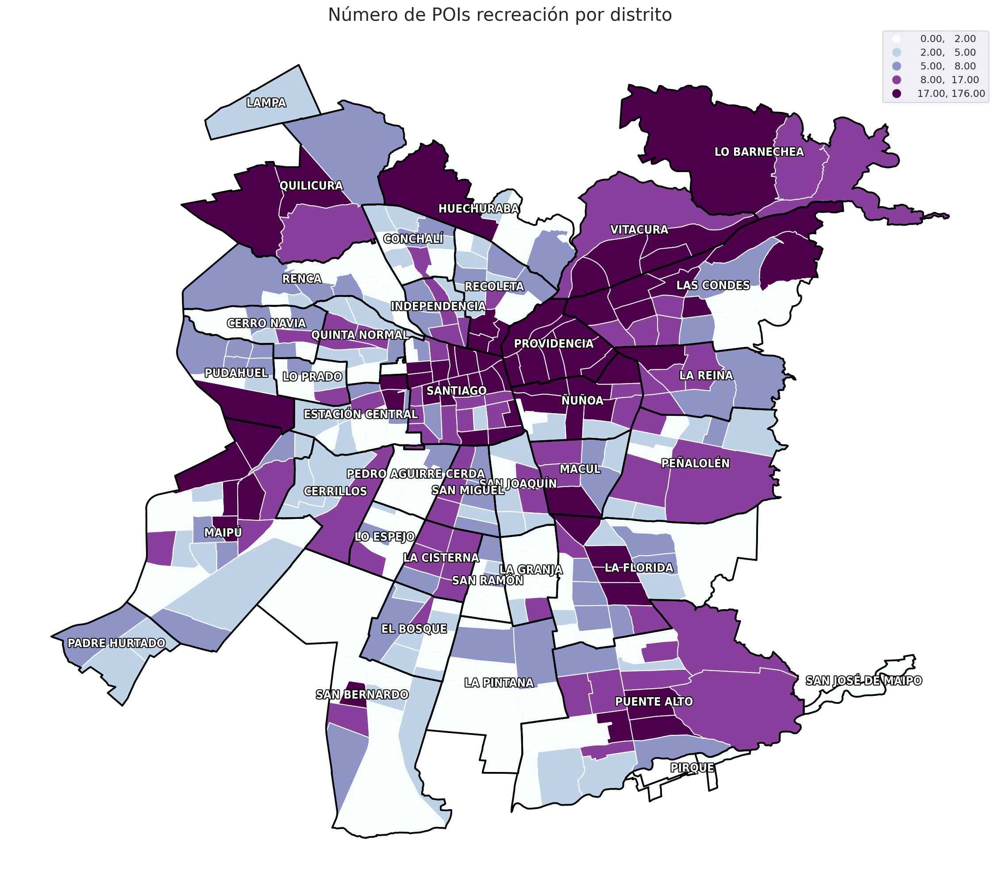

In [18]:
plot_distritos(data, column='Recreacion', title='Número de POIs recreación por distrito')
plt.savefig('/home/jsepulveda/images/pois_recreacion_distritos.png', dpi=150, bbox_inches='tight');

/home/jsepulveda/miniconda3/envs/myenv/lib/python3.9/site-packages/mapclassify/classifiers.py:234: UserWarning: Warning: Not enough unique values in array to form k classes
  Warn(
/home/jsepulveda/miniconda3/envs/myenv/lib/python3.9/site-packages/mapclassify/classifiers.py:237: UserWarning: Warning: setting k to 4
  Warn("Warning: setting k to %d" % k_q, UserWarning)


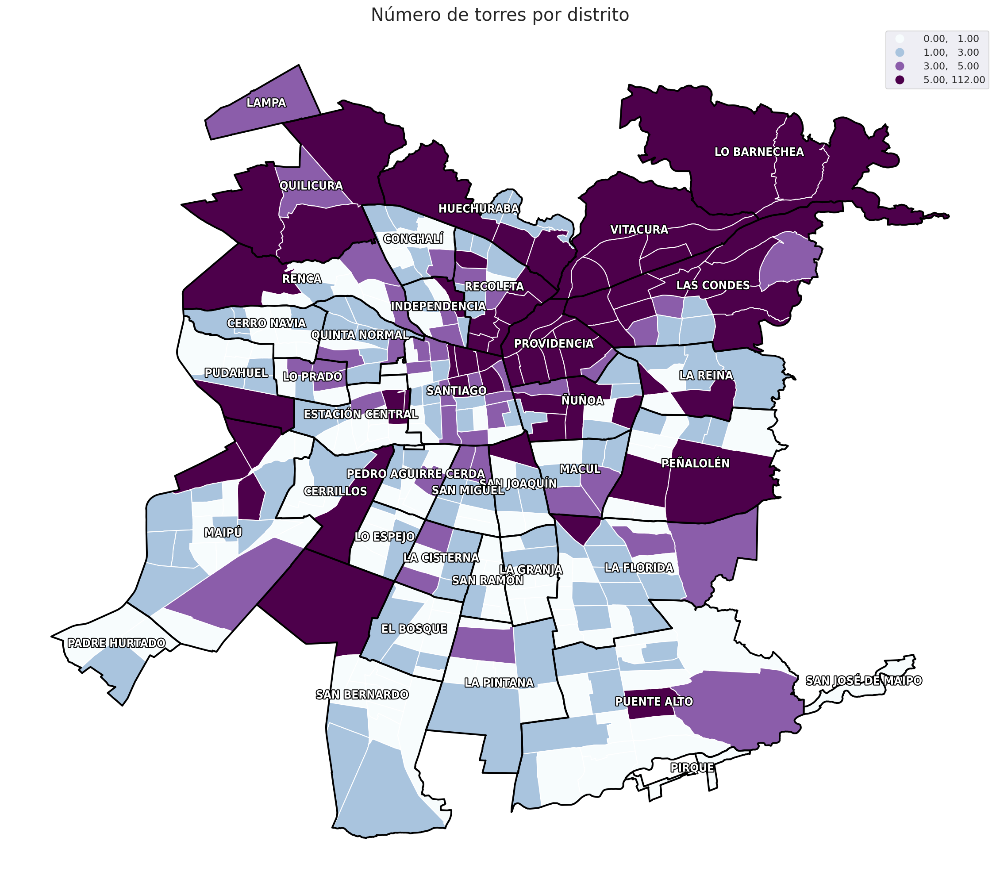

In [19]:
plot_distritos(data, column='Torres', title='Número de torres por distrito')
plt.savefig('/home/jsepulveda/images/torres_distritos.png', dpi=150, bbox_inches='tight');

### Descubriendo las torres cercanas a la Línea 6 del metro


### Radio de 500 metros desde la Línea 6

In [32]:
ruta_gdf.drop(['Unnamed: 0'], axis = 1)
ruta_buffer = ruta_gdf.copy()
ruta_buffer = ruta_buffer.to_crs(epsg=7855).buffer(500).to_crs(epsg=4326)

/home/jsepulveda/miniconda3/envs/myenv/lib/python3.9/site-packages/geopandas/plotting.py:641: UserWarning: Only specify one of 'column' or 'color'. Using 'color'.
  warnings.warn(


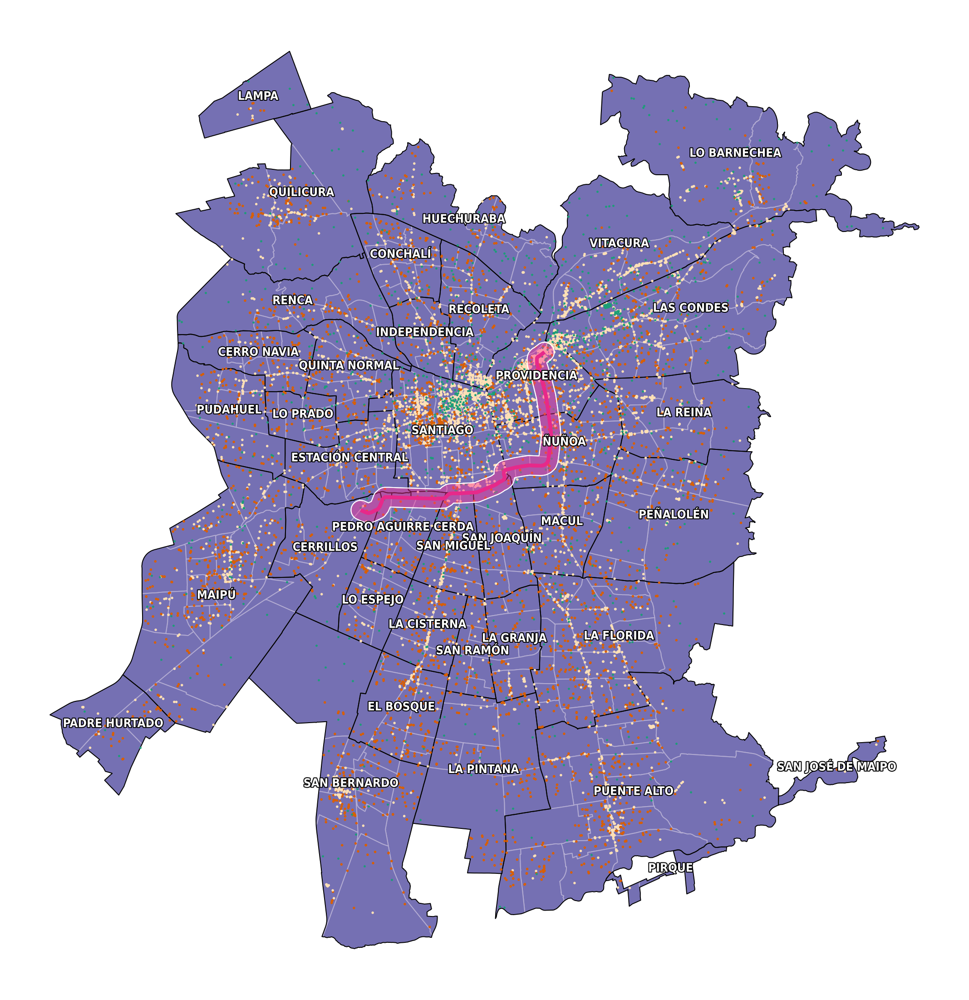

In [33]:
colors=['#d95f02' if amenity == 'Educacion' else '#fee0b6' for amenity in amenity_gdf.amenity]
ax = urban_distritos.plot(figsize=(20,20),linewidth=1, edgecolor='#b2abd2', facecolor='#7570b3')
ax = urban_comunas.plot(linewidth=1, edgecolor='black', facecolor="none", ax=ax)
ax = amenity_gdf.plot(column='amenity', figsize=(20,20),markersize=3,legend=True,ax=ax, color = colors)
ax = torres_gdf.plot(marker='*', color='#1b9e77',markersize=3,ax=ax)
ax = ruta_buffer.plot(color = '#FF339940', linewidth = 1, ax=ax)
ax = ruta_gdf.plot(color='#e7298a',linewidth=4,ax=ax)


texts = []
for comuna, centroid in zip(urban_comunas['NOM_COMUNA'], urban_comunas.centroid):
    t = ax.text(centroid.x, centroid.y, comuna, **text_style)
    t.set_path_effects(text_effects)
    texts.append(t)
adjust_text(texts, autoalign='y', lim=1)
    
ax.axis('off');

In [34]:
buffer_gdf = gpd.GeoDataFrame(geometry=ruta_buffer)
buffer_gdf.head()

,geometry
0,"POLYGON ((-70.61074 -33.46189, -70.61070 -33.4..."
1,"POLYGON ((-70.61074 -33.46189, -70.61070 -33.4..."


In [35]:
torres_cercanas = gpd.sjoin(torres_gdf,buffer_gdf, how='inner', op = 'intersects').reset_index().drop(['index_right','index'], axis = 1)
print(torres_cercanas)

    rinhead                     geometry           NOM_COMUNA
0     11SEP  POINT (-70.61111 -33.42227)          PROVIDENCIA
1     CAMCH  POINT (-70.60911 -33.41897)          PROVIDENCIA
2     CCA1A  POINT (-70.60588 -33.41796)          PROVIDENCIA
3     CCA1B  POINT (-70.60588 -33.41796)          PROVIDENCIA
4     CCA1C  POINT (-70.60588 -33.41796)          PROVIDENCIA
..      ...                          ...                  ...
303   HBCF1  POINT (-70.68701 -33.48443)  PEDRO AGUIRRE CERDA
304   MILAN  POINT (-70.65083 -33.47694)           SAN MIGUEL
305   UCXC1  POINT (-70.64320 -33.47735)           SAN MIGUEL
306   PBICF  POINT (-70.68659 -33.48132)            CERRILLOS
307   RVICT  POINT (-70.69552 -33.48230)            CERRILLOS

[308 rows x 3 columns]


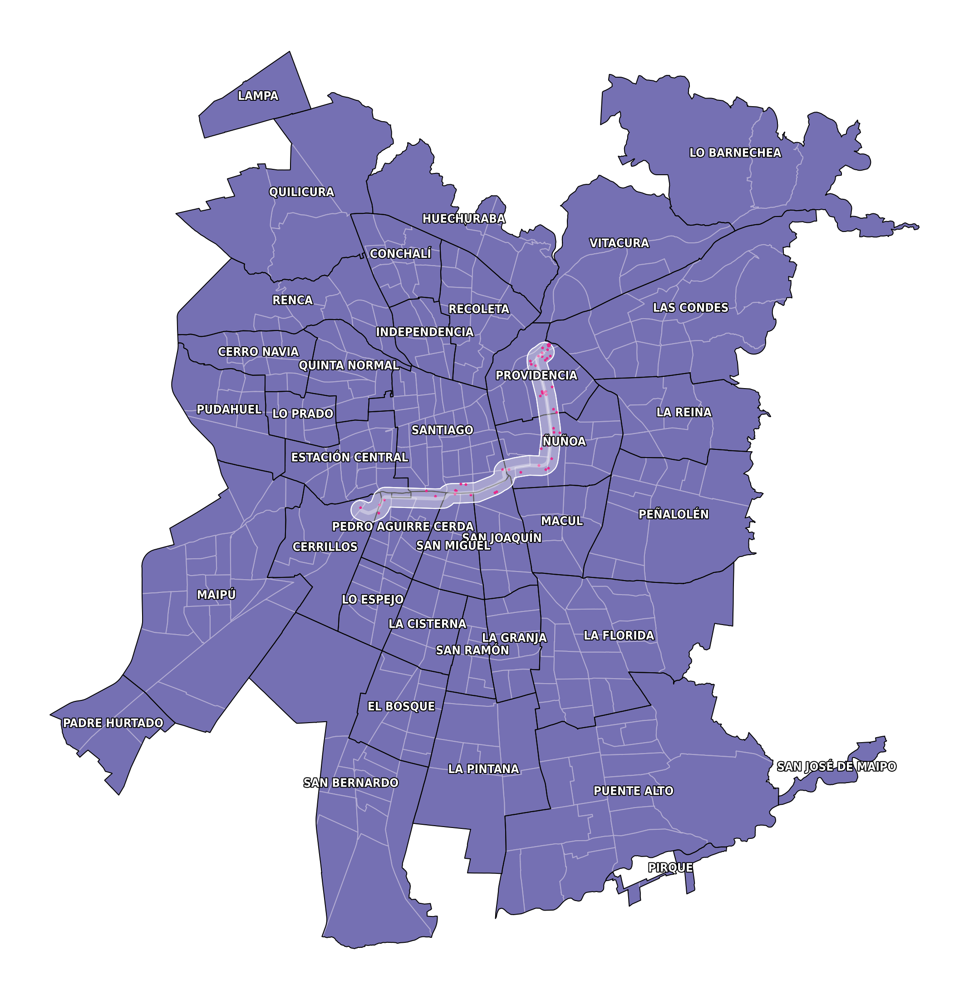

In [36]:
colors=['#d95f02' if amenity == 'Educacion' else '#fee0b6' for amenity in amenity_gdf.amenity]
ax = urban_distritos.plot(figsize=(20,20),linewidth=1, edgecolor='#b2abd2', facecolor='#7570b3')
ax = urban_comunas.plot(linewidth=1, edgecolor='black', facecolor="none", ax=ax)
ax = ruta_buffer.plot(color = '#FFFFFF33', linewidth = 1, ax=ax)
ax = ruta_gdf.plot(color='#FFFFFF33',linewidth=4,ax=ax)
ax = torres_cercanas.plot(marker='*', color='#e7298a',markersize=5,ax=ax)


texts = []
for comuna, centroid in zip(urban_comunas['NOM_COMUNA'], urban_comunas.centroid):
    t = ax.text(centroid.x, centroid.y, comuna, **text_style)
    t.set_path_effects(text_effects)
    texts.append(t)
adjust_text(texts, autoalign='y', lim=1)
    
ax.axis('off');

### Radio de 1 kilómetro desde la Línea 6

In [21]:
ruta_gdf.drop(['Unnamed: 0'], axis = 1)
ruta_buffer = ruta_gdf.copy()
ruta_buffer = ruta_buffer.to_crs(epsg=7855).buffer(1000).to_crs(epsg=4326)

/home/jsepulveda/miniconda3/envs/myenv/lib/python3.9/site-packages/geopandas/plotting.py:641: UserWarning: Only specify one of 'column' or 'color'. Using 'color'.
  warnings.warn(


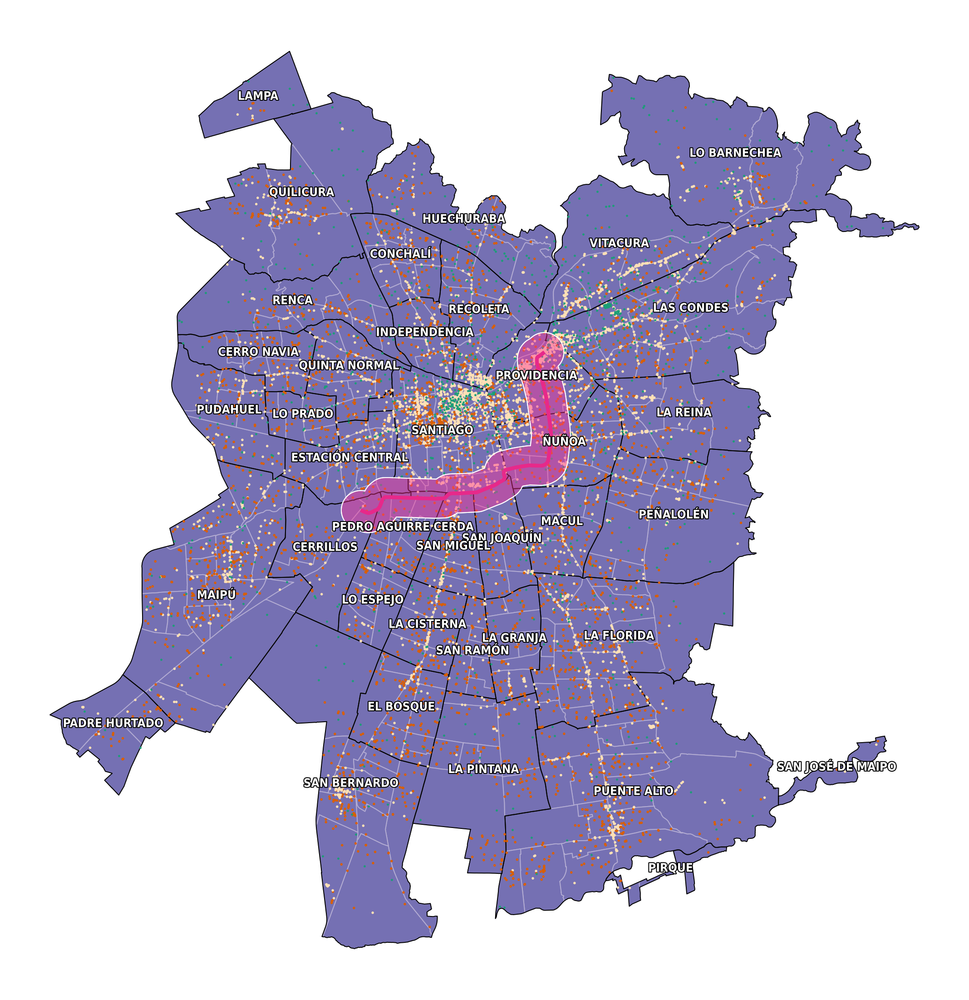

In [22]:
colors=['#d95f02' if amenity == 'Educacion' else '#fee0b6' for amenity in amenity_gdf.amenity]
ax = urban_distritos.plot(figsize=(20,20),linewidth=1, edgecolor='#b2abd2', facecolor='#7570b3')
ax = urban_comunas.plot(linewidth=1, edgecolor='black', facecolor="none", ax=ax)
ax = amenity_gdf.plot(column='amenity', figsize=(20,20),markersize=3,legend=True,ax=ax, color = colors)
ax = torres_gdf.plot(marker='*', color='#1b9e77',markersize=3,ax=ax)
ax = ruta_buffer.plot(color = '#FF339940', linewidth = 1, ax=ax)
ax = ruta_gdf.plot(color='#e7298a',linewidth=4,ax=ax)


texts = []
for comuna, centroid in zip(urban_comunas['NOM_COMUNA'], urban_comunas.centroid):
    t = ax.text(centroid.x, centroid.y, comuna, **text_style)
    t.set_path_effects(text_effects)
    texts.append(t)
adjust_text(texts, autoalign='y', lim=1)
    
ax.axis('off');

In [24]:
buffer_gdf = gpd.GeoDataFrame(geometry=ruta_buffer)
buffer_gdf.head()

,geometry
0,"POLYGON ((-70.61863 -33.47389, -70.61871 -33.4..."
1,"POLYGON ((-70.61863 -33.47389, -70.61871 -33.4..."


In [25]:
torres_cercanas = gpd.sjoin(torres_gdf,buffer_gdf, how='inner', op = 'intersects').reset_index().drop(['index_right','index'], axis = 1)
print(torres_cercanas)

    rinhead                     geometry        NOM_COMUNA
0     11SEP  POINT (-70.61111 -33.42227)       PROVIDENCIA
1     ATICF  POINT (-70.60563 -33.42468)       PROVIDENCIA
2     BARRO  POINT (-70.61785 -33.43059)       PROVIDENCIA
3     BELET  POINT (-70.61900 -33.42553)       PROVIDENCIA
4     CAMCH  POINT (-70.60911 -33.41897)       PROVIDENCIA
..      ...                          ...               ...
415   BOSAF  POINT (-70.69400 -33.47665)  ESTACIÓN CENTRAL
416   MECEF  POINT (-70.68586 -33.47335)  ESTACIÓN CENTRAL
417   LOCLB  POINT (-70.69269 -33.47866)         CERRILLOS
418   PBICF  POINT (-70.68659 -33.48132)         CERRILLOS
419   RVICT  POINT (-70.69552 -33.48230)         CERRILLOS

[420 rows x 3 columns]


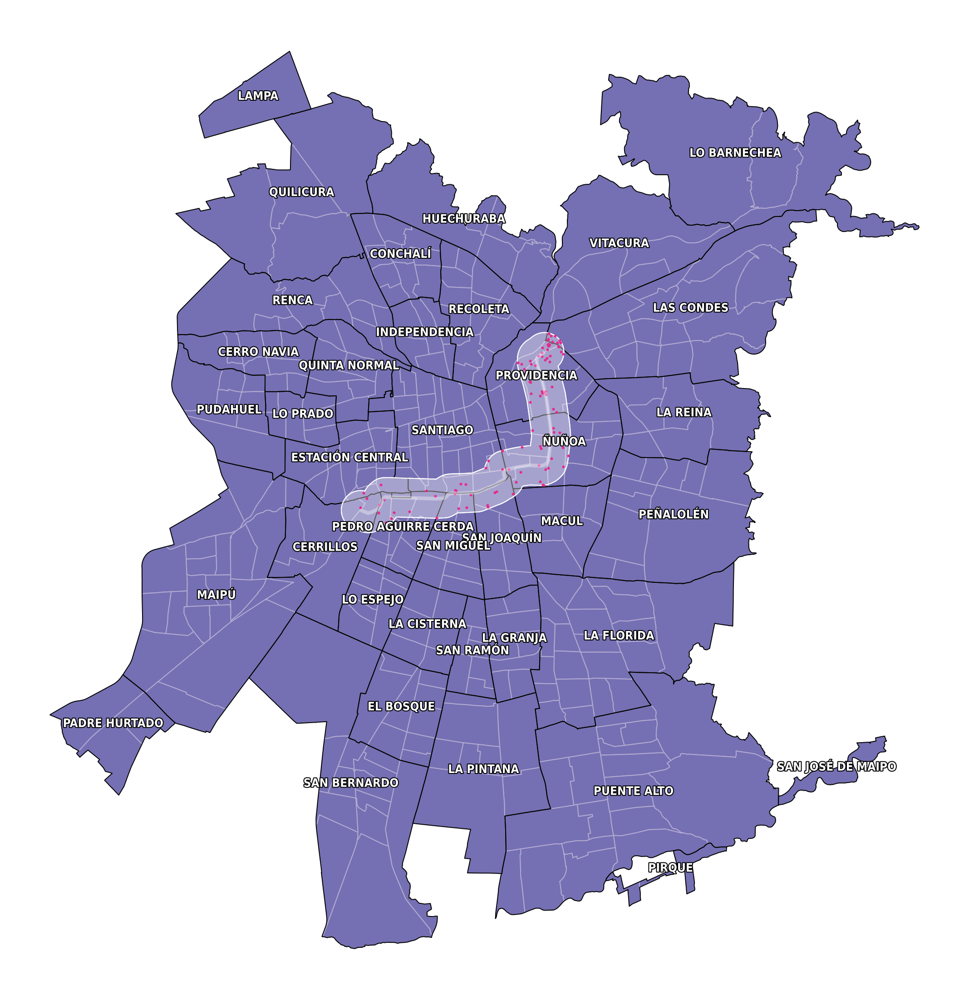

In [26]:
colors=['#d95f02' if amenity == 'Educacion' else '#fee0b6' for amenity in amenity_gdf.amenity]
ax = urban_distritos.plot(figsize=(20,20),linewidth=1, edgecolor='#b2abd2', facecolor='#7570b3')
ax = urban_comunas.plot(linewidth=1, edgecolor='black', facecolor="none", ax=ax)
ax = ruta_buffer.plot(color = '#FFFFFF33', linewidth = 1, ax=ax)
ax = ruta_gdf.plot(color='#FFFFFF33',linewidth=4,ax=ax)
ax = torres_cercanas.plot(marker='*', color='#e7298a',markersize=5,ax=ax)


texts = []
for comuna, centroid in zip(urban_comunas['NOM_COMUNA'], urban_comunas.centroid):
    t = ax.text(centroid.x, centroid.y, comuna, **text_style)
    t.set_path_effects(text_effects)
    texts.append(t)
adjust_text(texts, autoalign='y', lim=1)
    
ax.axis('off');

### Radio de 1.5 kilómetros desde la Línea 6

In [27]:
ruta_gdf.drop(['Unnamed: 0'], axis = 1)
ruta_buffer = ruta_gdf.copy()
ruta_buffer = ruta_buffer.to_crs(epsg=7855).buffer(1500).to_crs(epsg=4326)

/home/jsepulveda/miniconda3/envs/myenv/lib/python3.9/site-packages/geopandas/plotting.py:641: UserWarning: Only specify one of 'column' or 'color'. Using 'color'.
  warnings.warn(


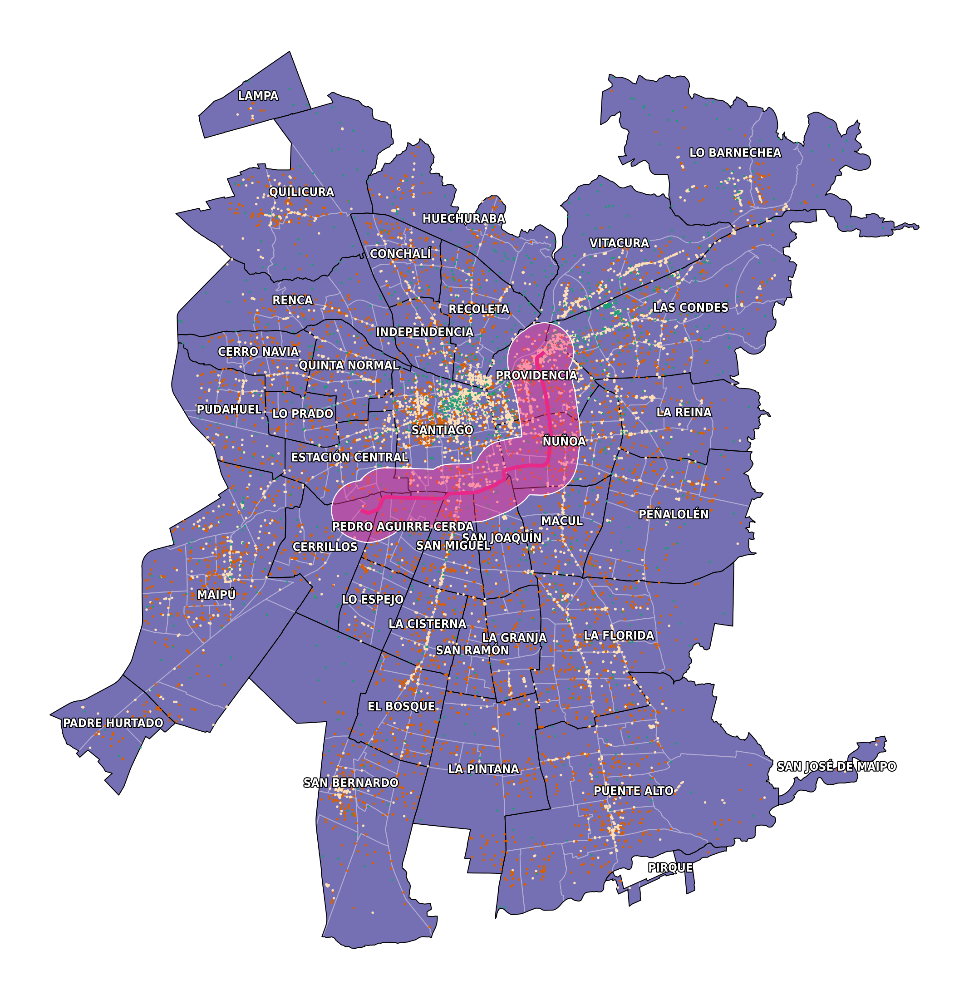

In [28]:
colors=['#d95f02' if amenity == 'Educacion' else '#fee0b6' for amenity in amenity_gdf.amenity]
ax = urban_distritos.plot(figsize=(20,20),linewidth=1, edgecolor='#b2abd2', facecolor='#7570b3')
ax = urban_comunas.plot(linewidth=1, edgecolor='black', facecolor="none", ax=ax)
ax = amenity_gdf.plot(column='amenity', figsize=(20,20),markersize=3,legend=True,ax=ax, color = colors)
ax = torres_gdf.plot(marker='*', color='#1b9e77',markersize=3,ax=ax)
ax = ruta_buffer.plot(color = '#FF339940', linewidth = 1, ax=ax)
ax = ruta_gdf.plot(color='#e7298a',linewidth=4,ax=ax)


texts = []
for comuna, centroid in zip(urban_comunas['NOM_COMUNA'], urban_comunas.centroid):
    t = ax.text(centroid.x, centroid.y, comuna, **text_style)
    t.set_path_effects(text_effects)
    texts.append(t)
adjust_text(texts, autoalign='y', lim=1)
    
ax.axis('off');

In [29]:
buffer_gdf = gpd.GeoDataFrame(geometry=ruta_buffer)
buffer_gdf.head()

,geometry
0,"POLYGON ((-70.61560 -33.47742, -70.61580 -33.4..."
1,"POLYGON ((-70.61560 -33.47742, -70.61580 -33.4..."


In [30]:
torres_cercanas = gpd.sjoin(torres_gdf,buffer_gdf, how='inner', op = 'intersects').reset_index().drop(['index_right','index'], axis = 1)
print(torres_cercanas)

    rinhead                     geometry        NOM_COMUNA
0     11SEP  POINT (-70.61111 -33.42227)       PROVIDENCIA
1     ATICF  POINT (-70.60563 -33.42468)       PROVIDENCIA
2     BARRO  POINT (-70.61785 -33.43059)       PROVIDENCIA
3     BELET  POINT (-70.61900 -33.42553)       PROVIDENCIA
4     BUSIS  POINT (-70.62233 -33.42679)       PROVIDENCIA
..      ...                          ...               ...
619   LEHB1  POINT (-70.69713 -33.47276)  ESTACIÓN CENTRAL
620   MECEF  POINT (-70.68586 -33.47335)  ESTACIÓN CENTRAL
621   LOCLB  POINT (-70.69269 -33.47866)         CERRILLOS
622   PBICF  POINT (-70.68659 -33.48132)         CERRILLOS
623   RVICT  POINT (-70.69552 -33.48230)         CERRILLOS

[624 rows x 3 columns]


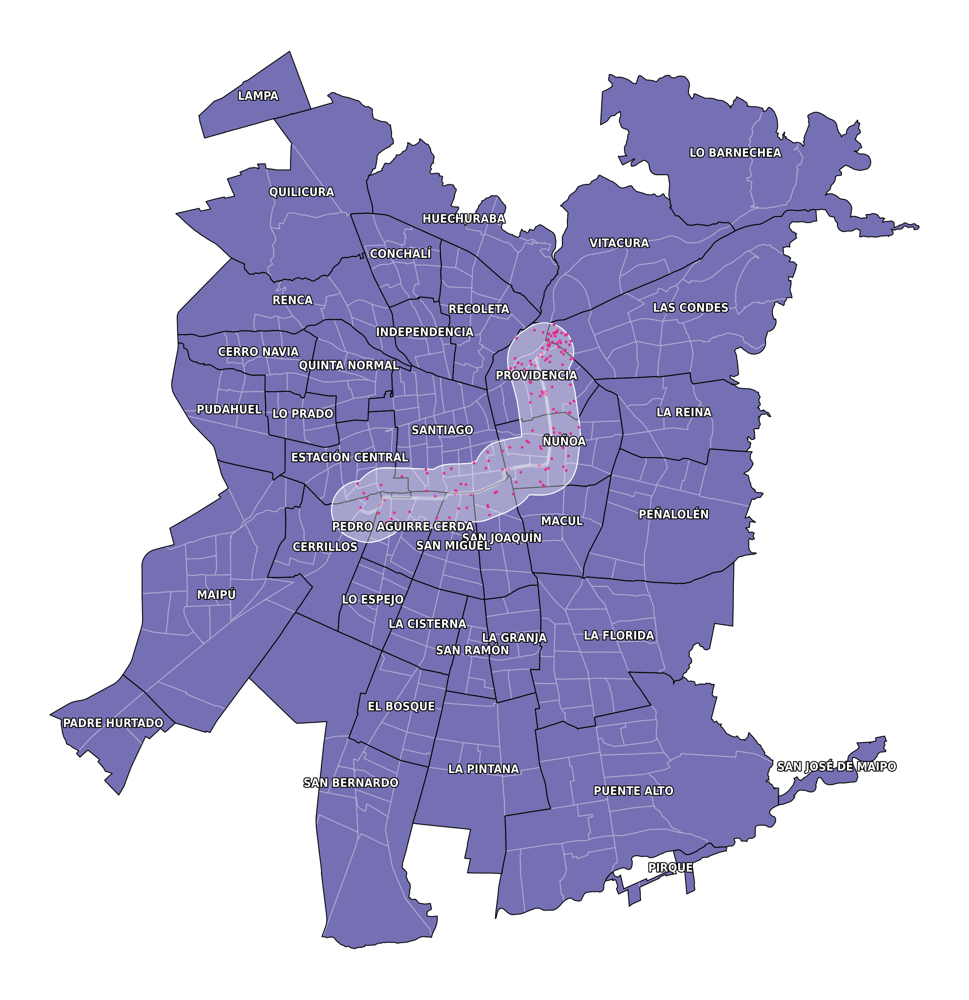

In [31]:
colors=['#d95f02' if amenity == 'Educacion' else '#fee0b6' for amenity in amenity_gdf.amenity]
ax = urban_distritos.plot(figsize=(20,20),linewidth=1, edgecolor='#b2abd2', facecolor='#7570b3')
ax = urban_comunas.plot(linewidth=1, edgecolor='black', facecolor="none", ax=ax)
ax = ruta_buffer.plot(color = '#FFFFFF33', linewidth = 1, ax=ax)
ax = ruta_gdf.plot(color='#FFFFFF33',linewidth=4,ax=ax)
ax = torres_cercanas.plot(marker='*', color='#e7298a',markersize=5,ax=ax)


texts = []
for comuna, centroid in zip(urban_comunas['NOM_COMUNA'], urban_comunas.centroid):
    t = ax.text(centroid.x, centroid.y, comuna, **text_style)
    t.set_path_effects(text_effects)
    texts.append(t)
adjust_text(texts, autoalign='y', lim=1)
    
ax.axis('off');

### Visualizando alcance de las torres

### Primer caso de cobertura de 800 metros

In [33]:
torres_buffer = torres_gdf.copy()
torres_buffer = torres_buffer.to_crs(epsg=7855).buffer(800).to_crs(epsg=4326)

/home/jsepulveda/miniconda3/envs/myenv/lib/python3.9/site-packages/geopandas/plotting.py:641: UserWarning: Only specify one of 'column' or 'color'. Using 'color'.
  warnings.warn(


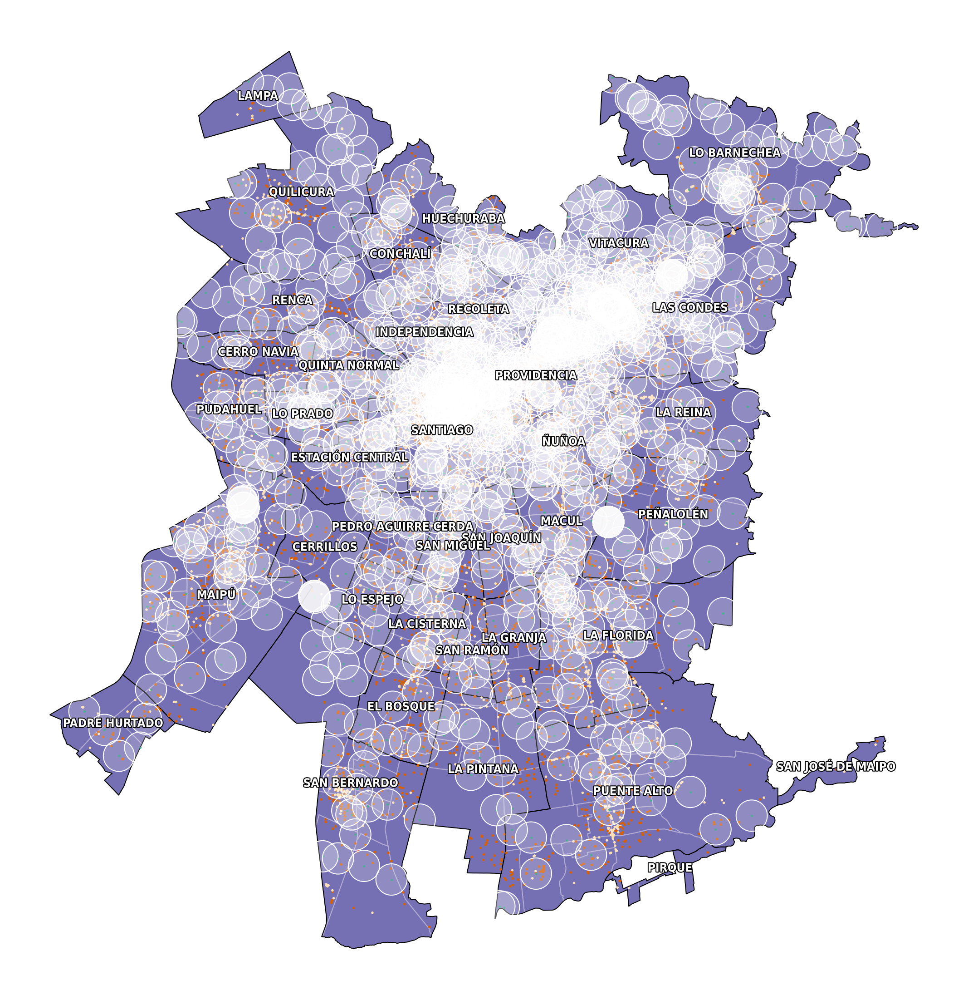

In [34]:
colors=['#d95f02' if amenity == 'Educacion' else '#fee0b6' for amenity in amenity_gdf.amenity] #naranjo educacion
ax = urban_distritos.plot(figsize=(20,20),linewidth=1, edgecolor='#b2abd2', facecolor='#7570b3')
ax = urban_comunas.plot(linewidth=1, edgecolor='black', facecolor="none", ax=ax)
ax = amenity_gdf.plot(column='amenity', figsize=(20,20),markersize=3,legend=True,ax=ax, color = colors)
ax = torres_gdf.plot(marker='*', color='#1b9e77',markersize=3,ax=ax)

ax = torres_buffer.plot(color = '#FFFFFF33', linewidth = 1, ax=ax)


texts = []
for comuna, centroid in zip(urban_comunas['NOM_COMUNA'], urban_comunas.centroid):
    t = ax.text(centroid.x, centroid.y, comuna, **text_style)
    t.set_path_effects(text_effects)
    texts.append(t)
adjust_text(texts, autoalign='y', lim=1)
    
ax.axis('off');

### Cobertura de 1.5 kilómetros

In [35]:
torres_buffer = torres_gdf.copy()
torres_buffer = torres_buffer.to_crs(epsg=7855).buffer(1500).to_crs(epsg=4326)

/home/jsepulveda/miniconda3/envs/myenv/lib/python3.9/site-packages/geopandas/plotting.py:641: UserWarning: Only specify one of 'column' or 'color'. Using 'color'.
  warnings.warn(


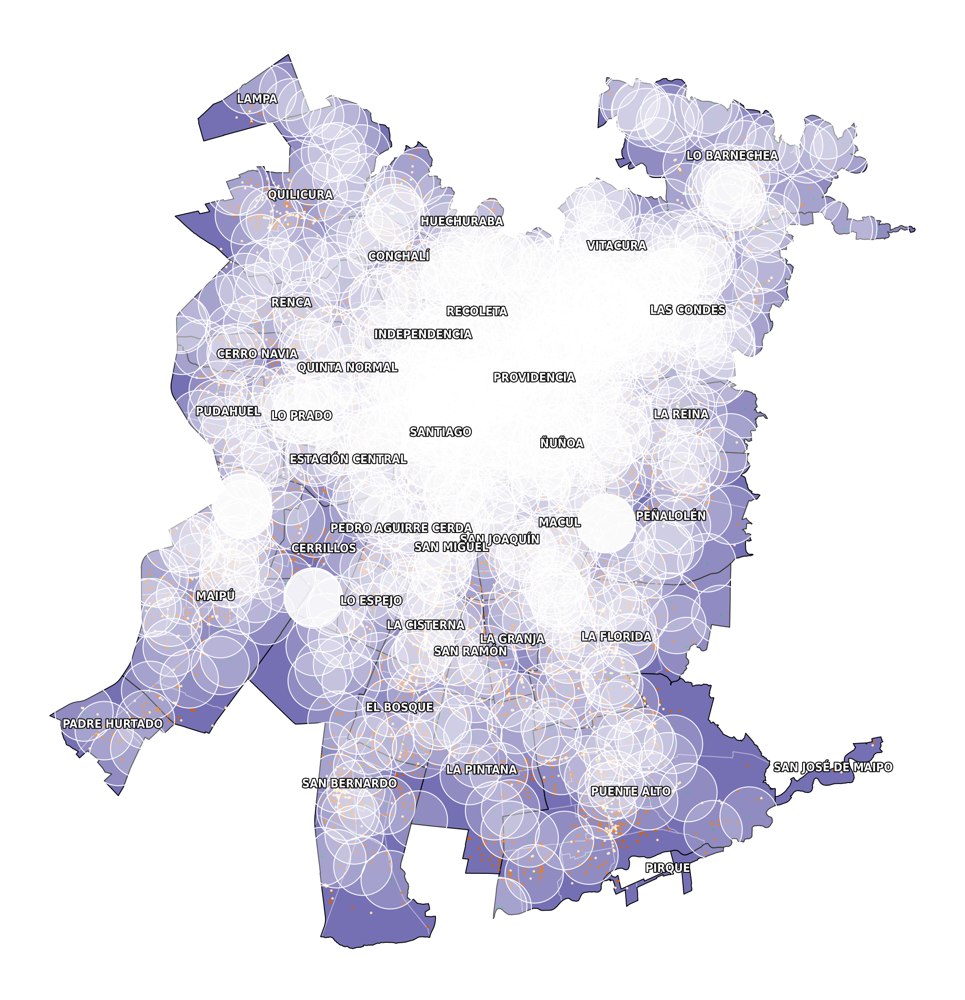

In [36]:
colors=['#d95f02' if amenity == 'Educacion' else '#fee0b6' for amenity in amenity_gdf.amenity] #naranjo educacion
ax = urban_distritos.plot(figsize=(20,20),linewidth=1, edgecolor='#b2abd2', facecolor='#7570b3')
ax = urban_comunas.plot(linewidth=1, edgecolor='black', facecolor="none", ax=ax)
ax = amenity_gdf.plot(column='amenity', figsize=(20,20),markersize=3,legend=True,ax=ax, color = colors)
ax = torres_gdf.plot(marker='*', color='#1b9e77',markersize=3,ax=ax)

ax = torres_buffer.plot(color = '#FFFFFF33', linewidth = 1, ax=ax)


texts = []
for comuna, centroid in zip(urban_comunas['NOM_COMUNA'], urban_comunas.centroid):
    t = ax.text(centroid.x, centroid.y, comuna, **text_style)
    t.set_path_effects(text_effects)
    texts.append(t)
adjust_text(texts, autoalign='y', lim=1)
    
ax.axis('off');

### Cobertura de 3 kilómetros

In [37]:
torres_buffer = torres_gdf.copy()
torres_buffer = torres_buffer.to_crs(epsg=7855).buffer(3000).to_crs(epsg=4326)

/home/jsepulveda/miniconda3/envs/myenv/lib/python3.9/site-packages/geopandas/plotting.py:641: UserWarning: Only specify one of 'column' or 'color'. Using 'color'.
  warnings.warn(


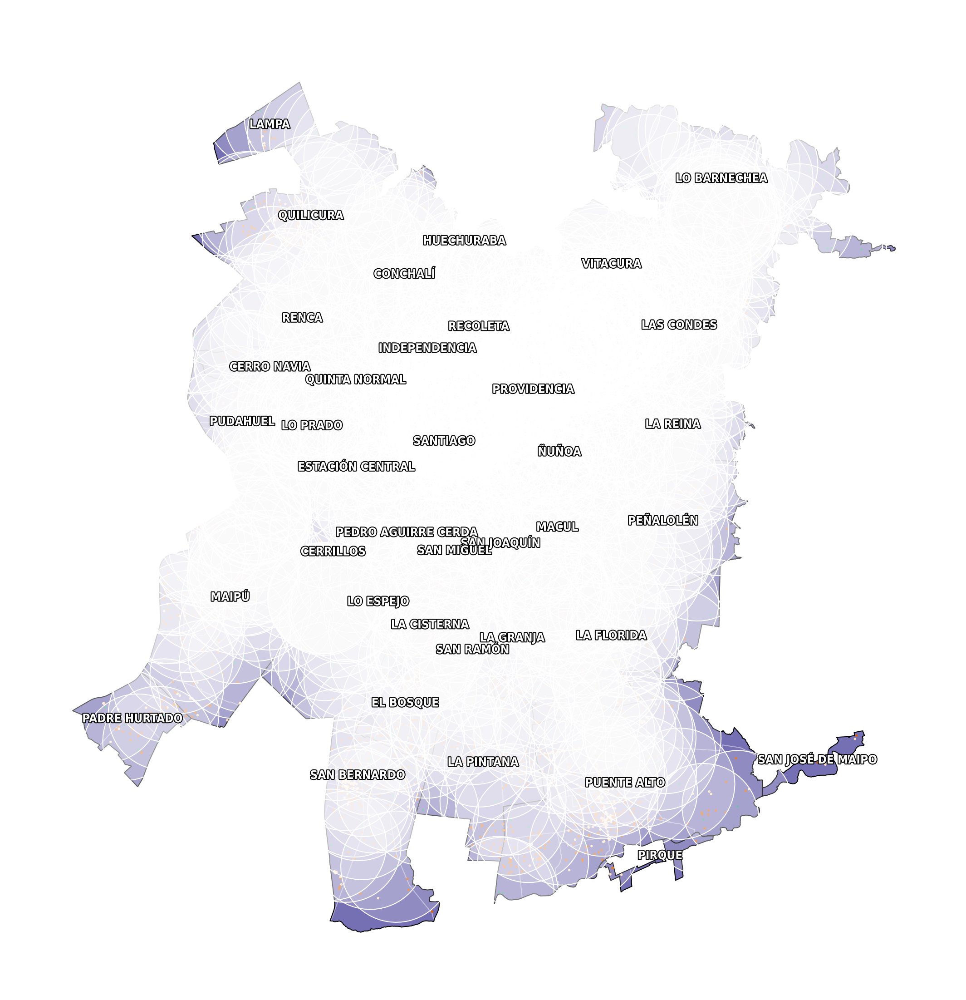

In [38]:
colors=['#d95f02' if amenity == 'Educacion' else '#fee0b6' for amenity in amenity_gdf.amenity] #naranjo educacion
ax = urban_distritos.plot(figsize=(20,20),linewidth=1, edgecolor='#b2abd2', facecolor='#7570b3')
ax = urban_comunas.plot(linewidth=1, edgecolor='black', facecolor="none", ax=ax)
ax = amenity_gdf.plot(column='amenity', figsize=(20,20),markersize=3,legend=True,ax=ax, color = colors)
ax = torres_gdf.plot(marker='*', color='#1b9e77',markersize=3,ax=ax)

ax = torres_buffer.plot(color = '#FFFFFF33', linewidth = 1, ax=ax)


texts = []
for comuna, centroid in zip(urban_comunas['NOM_COMUNA'], urban_comunas.centroid):
    t = ax.text(centroid.x, centroid.y, comuna, **text_style)
    t.set_path_effects(text_effects)
    texts.append(t)
adjust_text(texts, autoalign='y', lim=1)
    
ax.axis('off');